In [1]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [2]:
# Pip install method (recommended)

!pip install ultralytics==8.0.20

from IPython import display
display.clear_output()

import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.20 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 25.4/78.2 GB disk)


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [8]:
from ultralytics import YOLO

from IPython.display import display, Image

## CLI Basics 

If you want to train, validate or run inference on models and don't need to make any modifications to the code, using YOLO command line interface is the easiest way to get started. Read more about CLI in [Ultralytics YOLO Docs](https://v8docs.ultralytics.com/cli/).

```
yolo task=detect    mode=train    model=yolov8n.yaml      args...
          classify       predict        yolov8n-cls.yaml  args...
          segment        val            yolov8n-seg.yaml  args...
                         export         yolov8n.pt        format=onnx  args...
```

## Inference with Pre-trained COCO Model

### 💻 CLI

`yolo mode=predict` runs YOLOv8 inference on a variety of sources, downloading models automatically from the latest YOLOv8 release, and saving results to `runs/predict`.

In [9]:
# at the source keyword, just paste the path of your file.
%cd {HOME}
!yolo task=detect mode=predict model=yolov8n.pt conf=0.25 source='/content/cat dog.jpg' save=True

/content
100% 6.23M/6.23M [00:00<00:00, 6.97MB/s]

Ultralytics YOLOv8.0.20 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8n summary (fused): 168 layers, 3151904 parameters, 0 gradients, 8.7 GFLOPs
image 1/1 /content/cat dog.jpg: 352x640 1 cat, 14.8ms
Speed: 0.5ms pre-process, 14.8ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2


The above cell outputs that inferential result is saved to the destination runs/detect/predict2. 
Go there and copy the path and paste it in the below cell to print the result.

/content


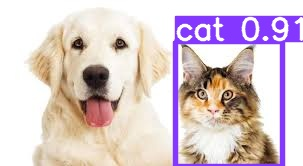

In [10]:
%cd {HOME}
Image(filename='/content/runs/detect/predict2/cat dog.jpg', height=600)

**Note yolov8n.pt model was not able to detect dog.**

## Custom Training

In [15]:
# I am using yolov8s.pt (small) weights for custom training.

!yolo task=detect mode=train model=yolov8s.pt data=/content/drive/MyDrive/custom2/data.yaml epochs=40 imgsz=800 plots=True

100% 21.5M/21.5M [00:01<00:00, 16.9MB/s]

Ultralytics YOLOv8.0.20 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/drive/MyDrive/custom2/data.yaml, epochs=40, patience=50, batch=16, imgsz=800, save=True, cache=False, device=, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optim

In [17]:
!ls /content/runs/detect/train/

args.yaml					    train_batch0.jpg
confusion_matrix.png				    train_batch1.jpg
events.out.tfevents.1678632925.80d5fdbe3d19.9122.0  train_batch2.jpg
F1_curve.png					    train_batch30.jpg
P_curve.png					    train_batch31.jpg
PR_curve.png					    train_batch32.jpg
R_curve.png					    val_batch0_labels.jpg
results.csv					    val_batch0_pred.jpg
results.png					    weights


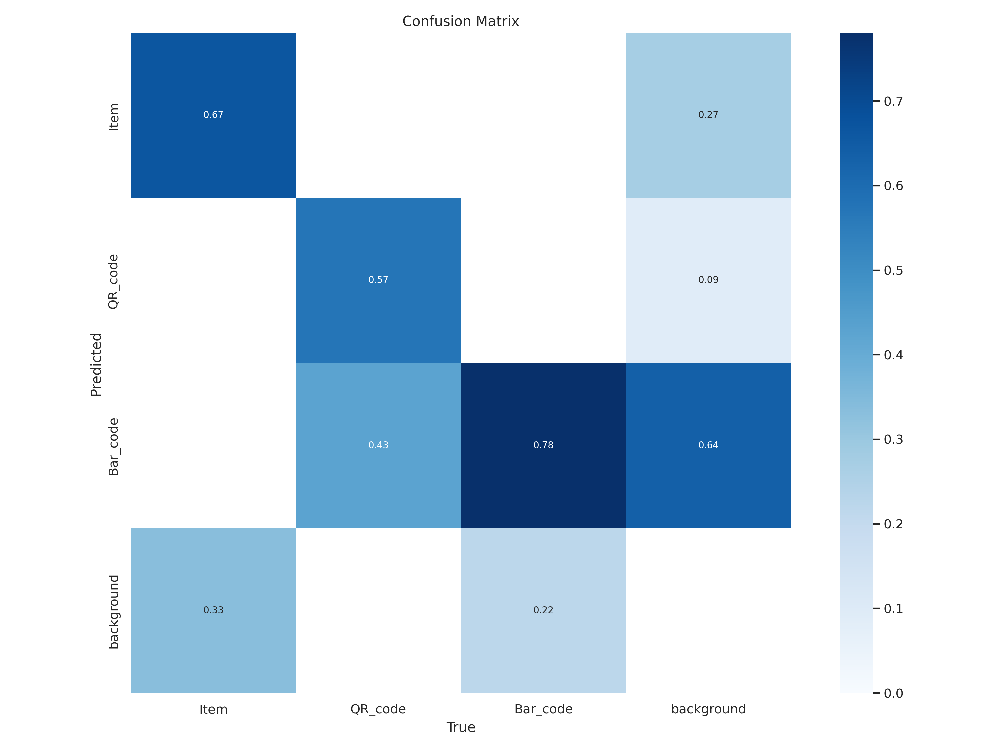

In [18]:
Image(filename=f'/content/runs/detect/train/confusion_matrix.png', width=600)

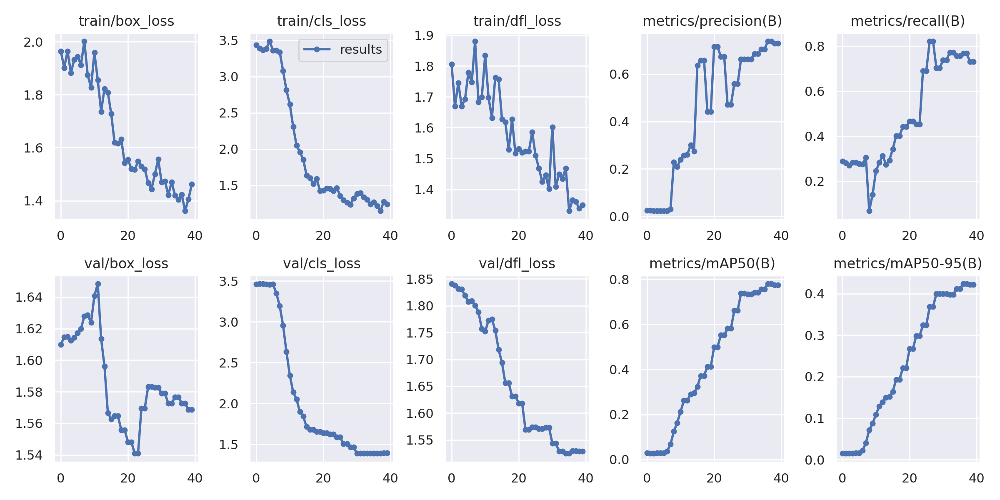

In [19]:
Image(filename=f'/content/runs/detect/train/results.png', width=600)

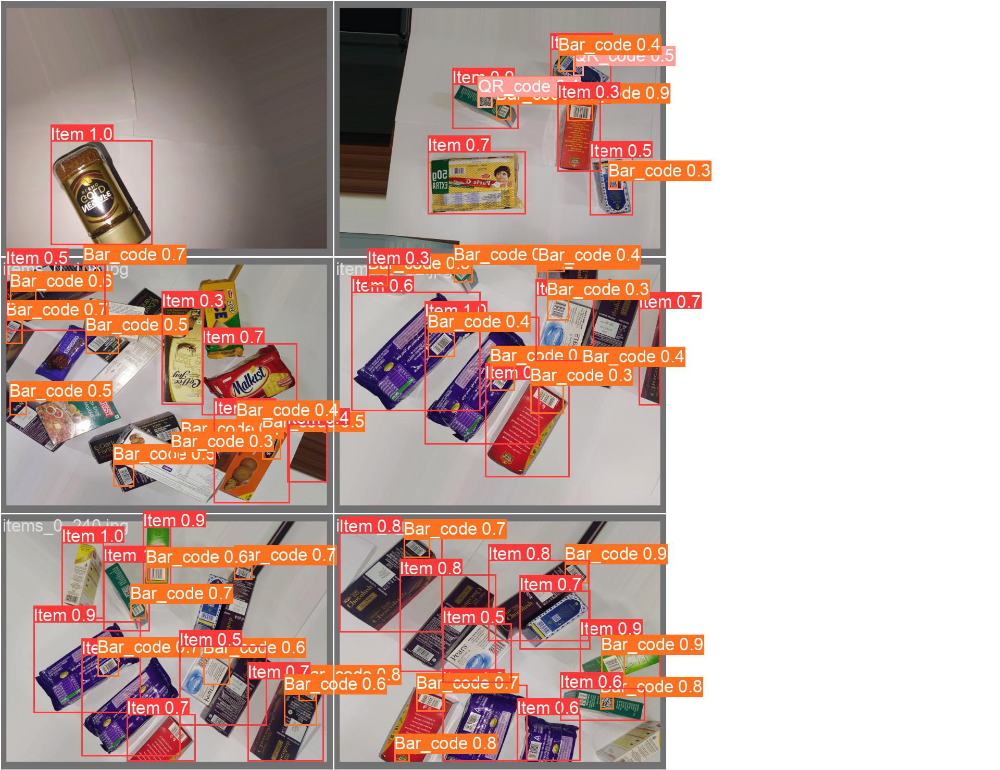

In [20]:
Image(filename=f'/content/runs/detect/train/val_batch0_pred.jpg', width=600)

## Validate Custom Model

In [21]:

!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data=/content/drive/MyDrive/custom2/data.yaml

Ultralytics YOLOv8.0.20 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/drive/MyDrive/custom2/val/labels.cache... 6 images, 0 backgrounds, 0 corrupt: 100% 6/6 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 1/1 [00:01<00:00,  1.33s/it]
                   all          6        102      0.734      0.768      0.779      0.416
                  Item          6         54      0.771      0.667      0.801      0.482
               QR_code          6          7      0.855      0.857      0.913      0.464
              Bar_code          6         41      0.575       0.78      0.623      0.303
Speed: 0.3ms pre-process, 16.7ms inference, 0.0ms loss, 2.9ms post-process per image


## Inference with Custom Model

In [22]:
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.25 source=/content/drive/MyDrive/custom2/test save=True

Ultralytics YOLOv8.0.20 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11126745 parameters, 0 gradients, 28.4 GFLOPs
image 1/13 /content/drive/MyDrive/custom2/test/1.jpg: 608x800 5 Items, 2 QR_codes, 5 Bar_codes, 20.8ms
image 2/13 /content/drive/MyDrive/custom2/test/10.jpg: 800x608 9 Items, 3 QR_codes, 19 Bar_codes, 20.7ms
image 3/13 /content/drive/MyDrive/custom2/test/11.jpg: 800x608 4 Items, 19.8ms
image 4/13 /content/drive/MyDrive/custom2/test/12.jpg: 800x608 3 Items, 19.8ms
image 5/13 /content/drive/MyDrive/custom2/test/13.jpg: 800x608 2 Items, 19.8ms
image 6/13 /content/drive/MyDrive/custom2/test/2.jpg: 800x608 9 Items, 2 QR_codes, 11 Bar_codes, 19.8ms
image 7/13 /content/drive/MyDrive/custom2/test/3.jpg: 800x608 1 Item, 2 Bar_codes, 19.8ms
image 8/13 /content/drive/MyDrive/custom2/test/4.jpg: 800x608 1 Item, 1 Bar_code, 19.8ms
image 9/13 /content/drive/MyDrive/custom2/test/5.jpg: 800x608 9 Items, 1 QR_code, 10 Bar_codes, 19.8ms
i

**NOTE:** Let's take a look at few results.

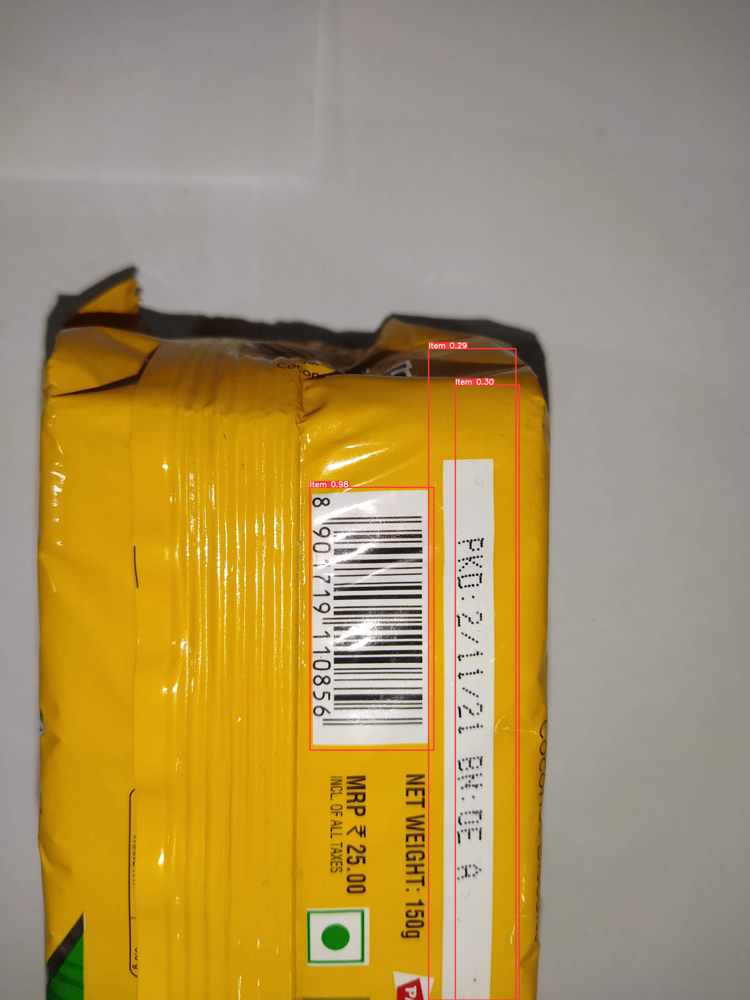

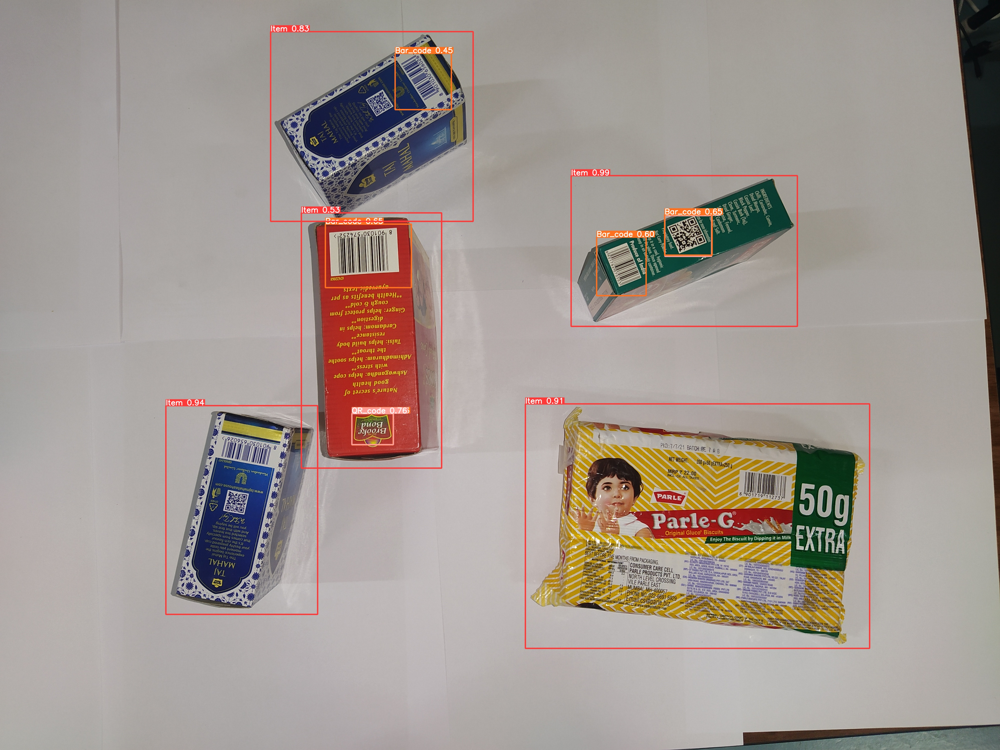

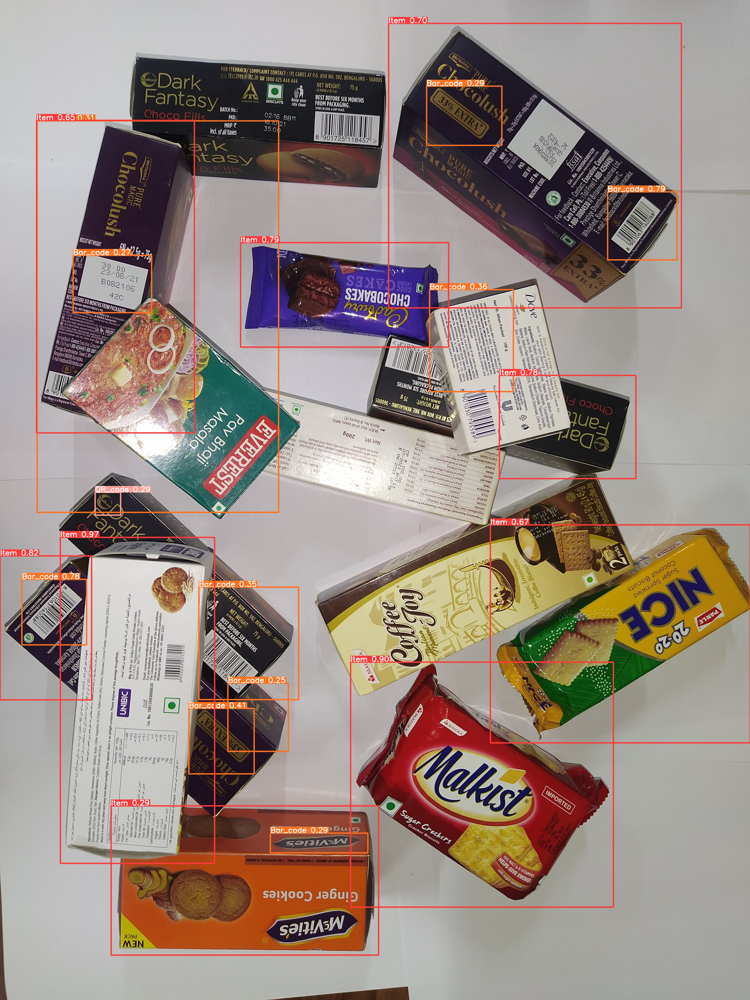

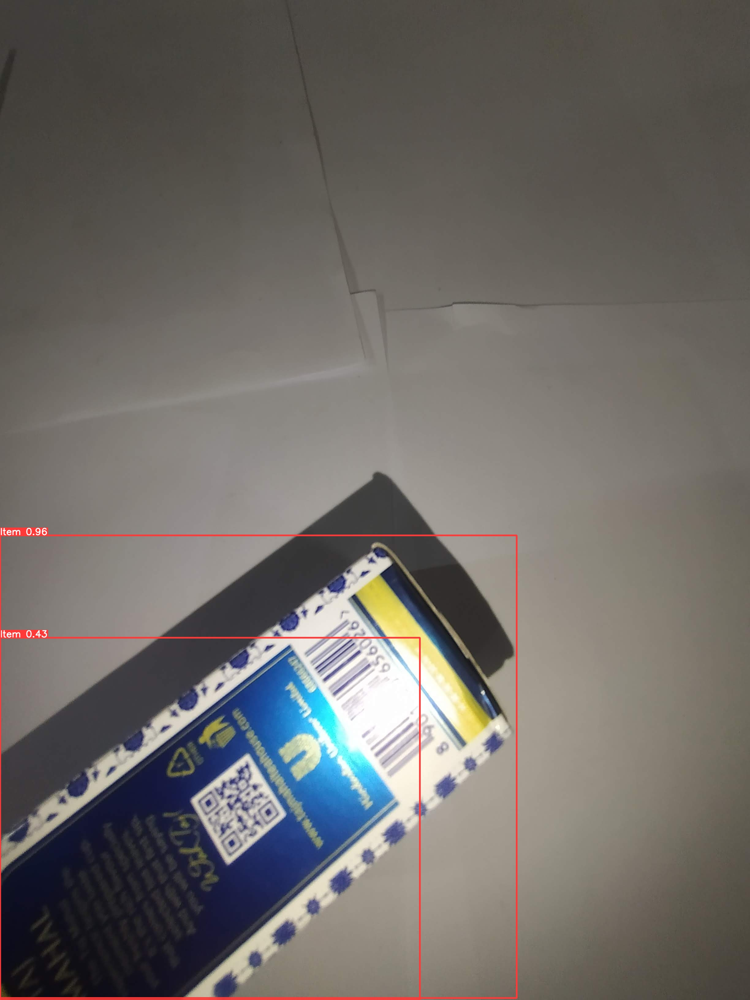

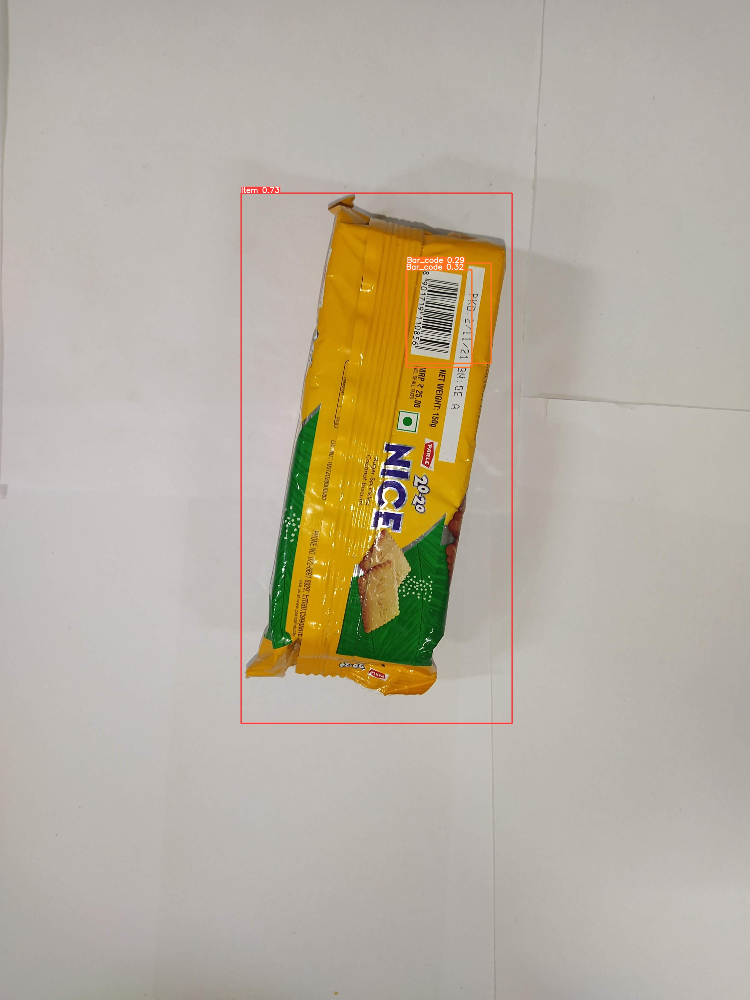

...

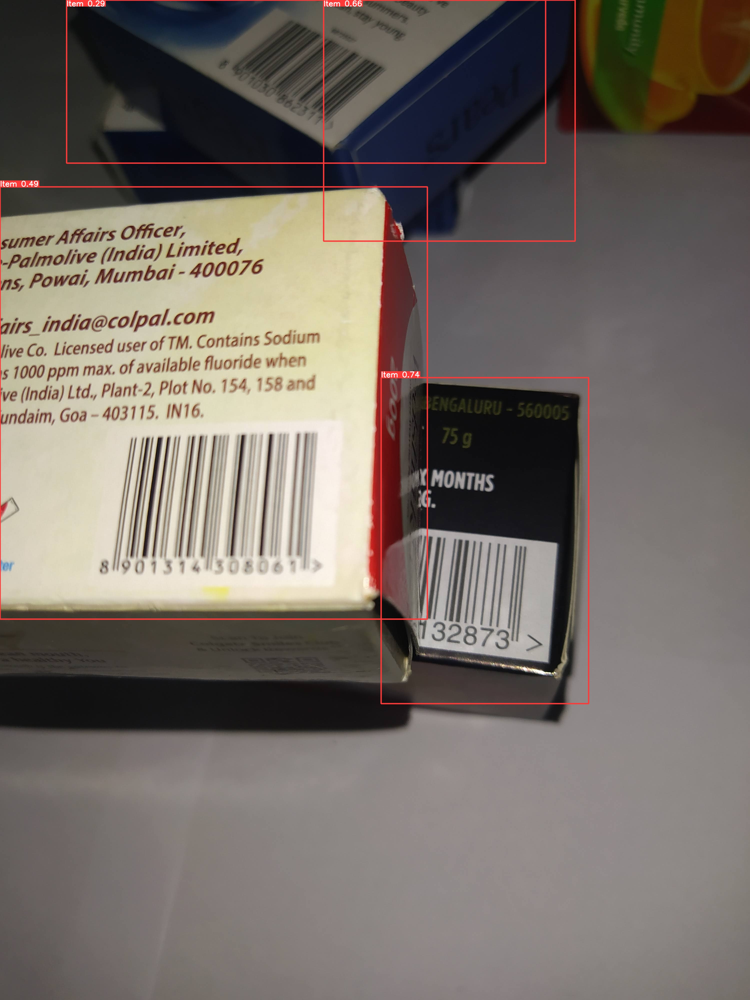

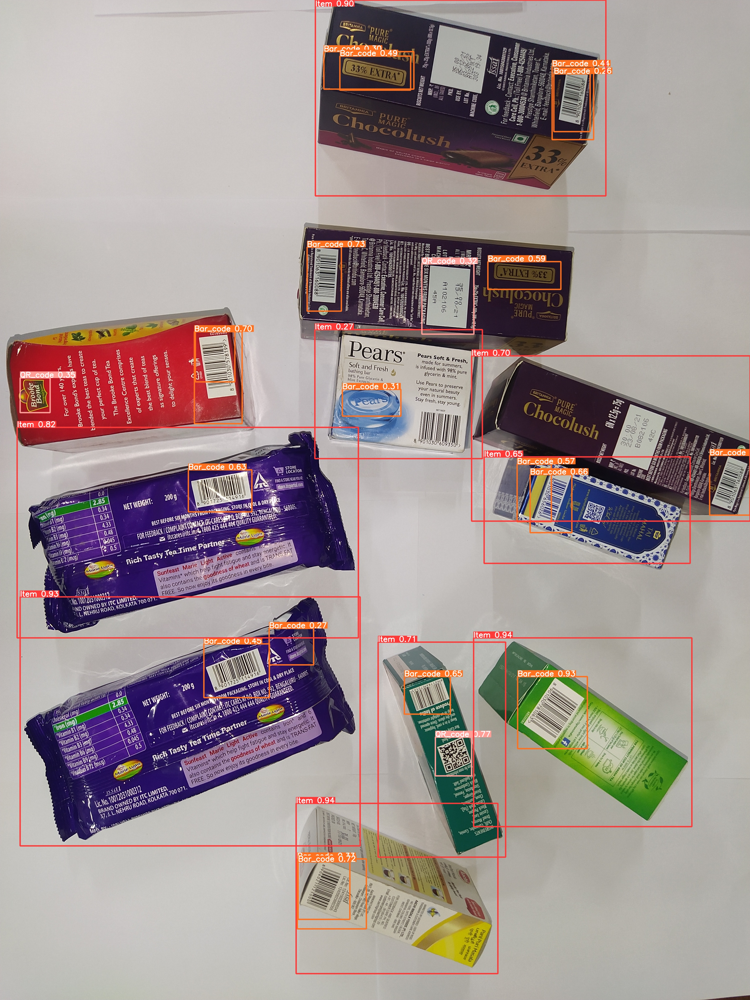

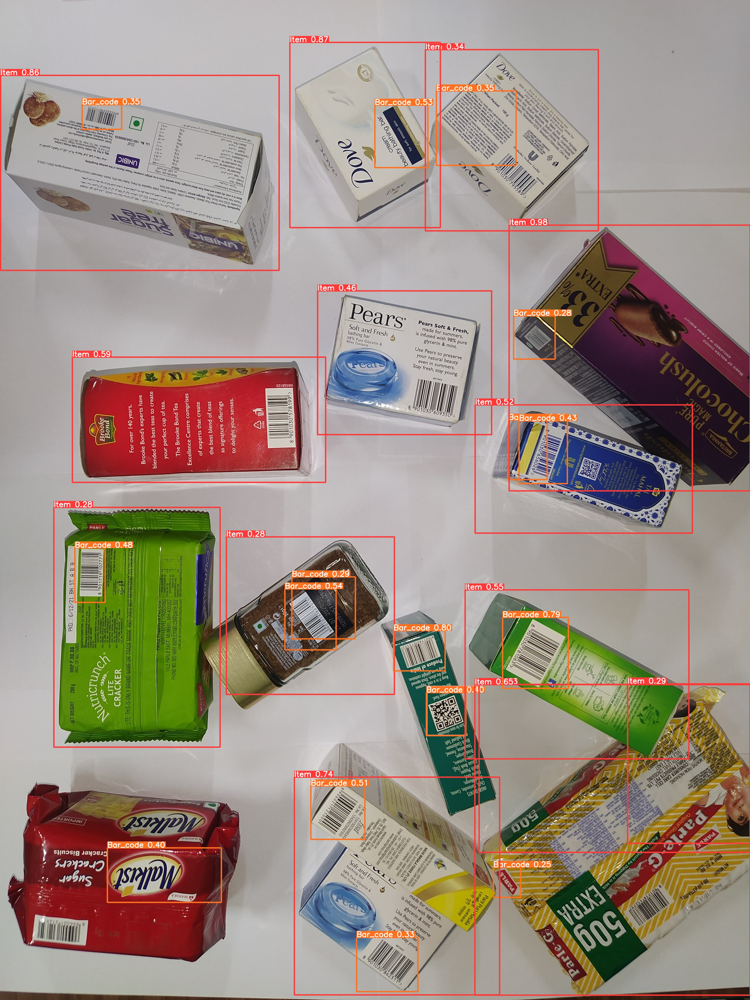

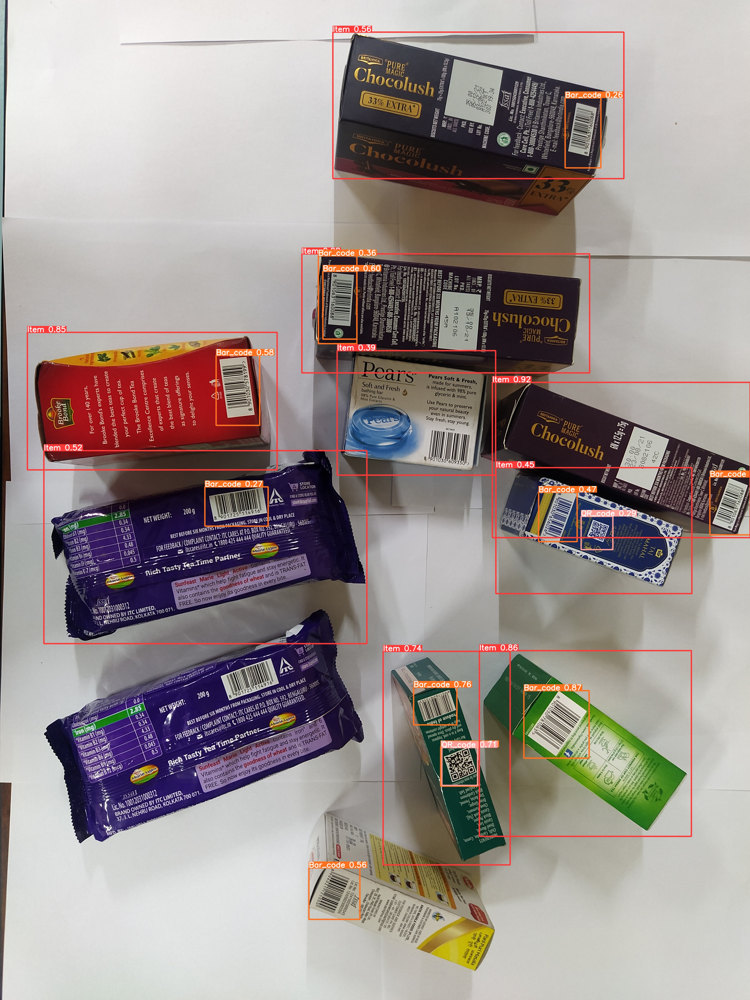

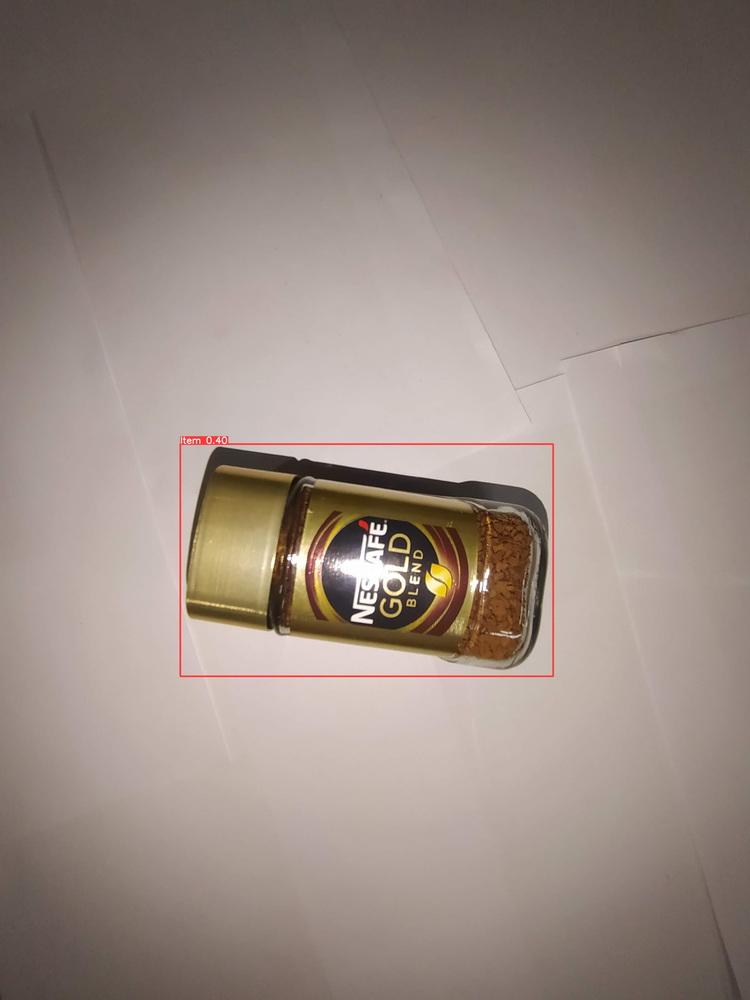

In [23]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict3/*.jpg')[:14]:
      display(Image(filename=image_path, width=600))
      print("\n")